In [1]:
import pandas as pd
from datetime import datetime

# Define the column names as provided
column_names = ['date', 'time', 'epoch', 'moteid', 'temperature', 'humidity', 'light', 'voltage']

# Load the data with proper column names
df = pd.read_csv('data/data.txt', sep=' ', header=None, names=column_names)

# Function to parse the time with fallback for different formats
def parse_time(time_str):
    try:
        return datetime.strptime(time_str, '%H:%M:%S.%f').time()
    except ValueError:
        try:
            return datetime.strptime(time_str, '%H:%M:%S').time()
        except ValueError:
            return None

# Apply the function to the 'time' column
df['time'] = df['time'].apply(parse_time)

# Ensure the 'date' column is parsed correctly
df['date'] = pd.to_datetime(df['date'], format='%Y-%m-%d', errors='coerce').dt.date

# Ensure correct data types for other columns
df['epoch'] = pd.to_numeric(df['epoch'], errors='coerce').astype('Int64')
df['moteid'] = pd.to_numeric(df['moteid'], errors='coerce').astype('Int64')
df['temperature'] = pd.to_numeric(df['temperature'], errors='coerce')
df['humidity'] = pd.to_numeric(df['humidity'], errors='coerce')
df['light'] = pd.to_numeric(df['light'], errors='coerce')
df['voltage'] = pd.to_numeric(df['voltage'], errors='coerce')

# Print the last few rows of the dataframe to verify
print(df.head())

# Optionally, handle any rows where the date or time could not be parsed
invalid_dates = df[df['date'].isna()]
invalid_times = df[df['time'].isna()]

print("Rows with invalid dates:")
print(invalid_dates)

print("Rows with invalid times:")
print(invalid_times)

         date             time  epoch  moteid  temperature  humidity  light  \
0  2004-03-31  03:38:15.757551      2       1     122.1530  -3.91901  11.04   
1  2004-02-28  00:59:16.027850      3       1      19.9884  37.09330  45.08   
2  2004-02-28  01:03:16.333930     11       1      19.3024  38.46290  45.08   
3  2004-02-28  01:06:16.013453     17       1      19.1652  38.80390  45.08   
4  2004-02-28  01:06:46.778088     18       1      19.1750  38.83790  45.08   

   voltage  
0  2.03397  
1  2.69964  
2  2.68742  
3  2.68742  
4  2.69964  
Rows with invalid dates:
Empty DataFrame
Columns: [date, time, epoch, moteid, temperature, humidity, light, voltage]
Index: []
Rows with invalid times:
Empty DataFrame
Columns: [date, time, epoch, moteid, temperature, humidity, light, voltage]
Index: []


In [2]:
# Ensure the 'date' column is in datetime format
df['date'] = pd.to_datetime(df['date'], format='%Y-%m-%d')
# Parse the 'time' column dynamically
df['time'] = pd.to_datetime(df['time'], errors='coerce', format='%H:%M:%S.%f').dt.time
df['time'] = df['time'].fillna(pd.to_datetime(df['time'], errors='coerce', format='%H:%M:%S').dt.time)

In [3]:
# Remove rows where 'time' could not be parsed (NaT values)
df = df.dropna(subset=['time'])

In [4]:
# Combine 'date' and 'time' into a single 'datetime' column
df['datetime'] = pd.to_datetime(df['date'].astype(str) + ' ' + df['time'].astype(str))

In [5]:
df = df[df['temperature'] <= 40]

In [6]:
import pandas as pd

# Assuming df is your existing DataFrame with a 'datetime' column and 'moteid'

# Ensure 'datetime' column is in datetime format
df['datetime'] = pd.to_datetime(df['datetime'])

# Remove duplicate rows if any
df = df.drop_duplicates()

# Check for mote IDs outside the expected range (1 to 54)
unexpected_moteids = df[~df['moteid'].isin(range(1, 55))]
if not unexpected_moteids.empty:
    print("Rows with unexpected mote IDs:")
    print(unexpected_moteids)

# Filter the DataFrame to keep only the mote IDs within the expected range
df = df[df['moteid'].isin(range(1, 55))]

# Identify mote IDs that have no values
motes_with_values = df.groupby('moteid')['temperature'].count()
motes_to_keep = motes_with_values[motes_with_values > 0].index.tolist()

# Filter the DataFrame to keep only the mote IDs with values
filtered_df = df[df['moteid'].isin(motes_to_keep)]

# Re-number the mote IDs from 1 to N
moteid_mapping = {old_id: new_id for new_id, old_id in enumerate(motes_to_keep, start=1)}
filtered_df['moteid'] = filtered_df['moteid'].map(moteid_mapping)

# Reset index to ensure the DataFrame is clean
filtered_df.reset_index(drop=True, inplace=True)

# Display the resulting DataFrame
print(filtered_df.head())

# Get a count of unique moteid
unique_moteid_count = filtered_df['moteid'].nunique()
print(f'Unique moteid count: {unique_moteid_count}')


Rows with unexpected mote IDs:
              date             time  epoch  moteid  temperature  humidity  \
2303290 2004-03-11  16:52:19.794238      2      55      26.2114   43.4524   
2303291 2004-03-12  09:15:21.526642      2      55      22.0170   41.7805   
2303292 2004-03-11  17:19:23.925033      2      55      25.4274   33.3507   
2303293 2004-03-11  17:15:52.136107      2      55      25.0158   33.9790   
2303294 2004-03-11  16:53:15.807424      4      55      26.2800   35.2995   
...            ...              ...    ...     ...          ...       ...   
2313149 2004-04-02  09:07:22.173243  62423      58      24.1436   21.7310   
2313150 2004-04-02  09:07:52.313870  62424      58      24.1436   21.6575   
2313151 2004-04-02  09:08:52.189274  62426      58      24.1240   21.5839   
2313152 2004-04-02  09:09:22.206544  62427      58      24.1044   21.4367   
2313154 2004-03-09  15:04:42.202647  30493   33117     -36.2048       NaN   

           light   voltage                  

In [13]:
import pandas as pd

# Assuming df is your existing DataFrame with a 'datetime' column and 'moteid'

# Ensure 'datetime' column is in datetime format
df['datetime'] = pd.to_datetime(df['datetime'])

# Remove duplicate rows if any
df = df.drop_duplicates()

# Check for mote IDs outside the expected range (1 to 54)
unexpected_moteids = df[~df['moteid'].isin(range(1, 55))]
if not unexpected_moteids.empty:
    print("Rows with unexpected mote IDs:")
    print(unexpected_moteids)
    # Optionally, drop these rows
    df = df[df['moteid'].isin(range(1, 55))]

# Identify mote IDs that have no values
motes_with_values = df.groupby('moteid')['voltage'].count()
motes_to_keep = motes_with_values[motes_with_values > 0].index.tolist()

# Filter the DataFrame to keep only the mote IDs with values
filtered_df = df[df['moteid'].isin(motes_to_keep)]

# Re-number the mote IDs from 1 to N
moteid_mapping = {old_id: new_id for new_id, old_id in enumerate(motes_to_keep, start=1)}
filtered_df['moteid'] = filtered_df['moteid'].map(moteid_mapping)

# Reset index to ensure the DataFrame is clean
filtered_df.reset_index(drop=True, inplace=True)

# Display the resulting DataFrame
print(filtered_df.tail())

# Get a count of unique moteid
unique_moteid_count = filtered_df['moteid'].nunique()
print(f'Unique moteid count: {unique_moteid_count}')


              date             time  epoch  moteid  temperature  humidity  \
1887403 2004-03-21  18:53:27.558979  65510      53      21.4780   47.6361   
1887404 2004-03-21  18:54:43.117051  65512      53      21.4780   47.6361   
1887405 2004-03-21  18:57:30.336879  65518      53      21.4192   47.6687   
1887406 2004-03-21  18:59:36.673512  65522      53      21.3996   47.7013   
1887407 2004-03-21  19:02:56.249587  65529      53      21.3604   47.8315   

         light  voltage                   datetime  
1887403   0.46  2.35683 2004-03-21 18:53:27.558979  
1887404   0.46  2.34751 2004-03-21 18:54:43.117051  
1887405   0.46  2.34751 2004-03-21 18:57:30.336879  
1887406   0.46  2.34751 2004-03-21 18:59:36.673512  
1887407   0.46  2.34751 2004-03-21 19:02:56.249587  
Unique moteid count: 53


In [14]:
import pandas as pd
import matplotlib.pyplot as plt


# Get the top 20 mote IDs (assuming they are in the range 1 to 54)
top_50_moteids = filtered_df['moteid'].unique()[:50]

# Re-number the mote IDs from 1 to 20
moteid_mapping = {old_id: new_id for new_id, old_id in enumerate(top_50_moteids, start=1)}
filtered_df['moteid'] = filtered_df['moteid'].map(moteid_mapping)

# Initialize an empty DataFrame to store the results
result_df = pd.DataFrame()

# Iterate over each specified moteid and get the first 5000 temperature values
for moteid in range(1, 51):
    mote_df = filtered_df[filtered_df['moteid'] == moteid]
    temp_df = mote_df[['voltage']].reset_index(drop=True)
    temp_df.columns = [f'mote{moteid}']
    if result_df.empty:
        result_df = temp_df
    else:
        result_df = pd.concat([result_df, temp_df], axis=1)

# Add the serial number (SN) column
result_df.insert(0, 'SN', range(1, len(result_df) + 1))

# Save the DataFrame to a CSV file
result_df.to_csv('top_fifty_motes_voltage.csv', index=False)




In [15]:
pivot_df = pd.read_csv('top_fifty_motes_voltage.csv')
pivot_df.head()

,SN,mote1,mote2,mote3,mote4,mote5,mote6,mote7,mote8,mote9,...,mote41,mote42,mote43,mote44,mote45,mote46,mote47,mote48,mote49,mote50
0,1,2.69964,2.67532,2.69964,2.51661,2.65143,2.68742,2.68742,2.77533,2.67532,...,2.52732,2.65143,2.67532,2.51661,2.38522,2.39484,2.57108,2.66332,2.67532,2.68742
1,2,2.68742,2.67532,2.68742,2.51661,2.63964,2.67532,2.68742,2.76242,2.67532,...,2.52732,2.52732,2.67532,2.51661,2.39484,2.67532,2.56000,2.65143,2.66332,2.54901
2,3,2.68742,2.66332,2.67532,2.51661,2.63964,2.68742,2.69964,2.77533,2.67532,...,2.51661,2.52732,2.67532,2.51661,2.38522,2.67532,2.56000,2.65143,2.66332,2.53812
3,4,2.69964,2.67532,2.68742,2.65143,2.63964,2.68742,2.68742,2.77533,2.67532,...,2.52732,2.52732,2.67532,2.51661,2.39484,2.67532,2.56000,2.51661,2.66332,2.67532
4,5,2.68742,2.67532,2.68742,2.65143,2.65143,2.68742,2.69964,2.74963,2.68742,...,2.68742,2.65143,2.67532,2.51661,2.38522,2.67532,2.54901,2.52732,2.66332,2.67532


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load the pivot DataFrame
pivot_df = pd.read_csv('top_fifty_motes_temperatures.csv')
pivot_df = pivot_df.head(10000)

# Parameters
A = np.array([[1, 1], [0, 1]])       # State transition matrix with delta_t=32 seconds
H = np.array([[1, 0]])                # Measurement matrix
Q = np.array([[1e-5, 0], [0, 1e-5]])  # Process noise covariance
R = np.array([[2]])                   # Measurement noise covariance
epsilon = 0.05                        # Sensitivity threshold for event detection
theta = 0.05                          # Threshold for significant change
num_nodes_to_poll = 20                 # Number of nodes to poll at each timestep
force_pull_threshold = 200             # Forcefully pull a node if it hasn't been pulled in the last 10 time steps

# Energy parameters in Joules
E_max = 162000  # Battery capacity in Joules
E_t = 50 / 1000  # Transmission energy in Joules
E_s = 10 / 1000  # Sensing energy in Joules
E_w = 10 / 1000  # Wake-up energy in Joules
E_0 = 1 / 1000   # Sleep energy in Joules

# Initialize state estimates and rate of change for each mote
state_estimates = {f'mote{i}': np.array([[20], [0.01]]) for i in range(1, 51)}
P = {f'mote{i}': np.eye(2) * 6 for i in range(1, 51)}

# Initialize previous timestamps for delta time calculation
last_sensed_values = {f'mote{i}': 20.0 for i in range(1, 51)}
last_update_times = {f'mote{i}': 0 for i in range(1, 51)}

# Initialize a list to store the most valuable sensor data and the associated metadata
valuable_sensor_data = []

# Initialize tracking arrays
polled_count = {f'mote{i}': 0 for i in range(1, 51)}
transmitted_count = {f'mote{i}': 0 for i in range(1, 51)}

# Function to predict node state
def predict_node_state(x_hat, delta_t):
    return A @ x_hat

# Function to select sensors based on predicted changes
def select_top_nodes(state_estimates, last_sensed_values, num_nodes_to_poll, delta_t_global, currently_polled_nodes):
    predicted_values = {mote: predict_node_state(state_estimates[mote], delta_t_global)[0, 0] for mote in state_estimates}
    value_changes = {mote: abs(predicted_values[mote] - last_sensed_values[mote]) for mote in state_estimates}
    top_nodes = sorted(value_changes, key=value_changes.get, reverse=True)
    # Filter out nodes that are already polled in this iteration
    top_nodes = [node for node in top_nodes if node not in currently_polled_nodes][:num_nodes_to_poll]
    return top_nodes

# Simulation loop
for idx, row in pivot_df.iterrows():
    current_time_step = idx
    delta_t_global = current_time_step - min(last_update_times.values())
    
    currently_polled_nodes = set()

    # Check if any node needs to be forcefully pulled due to inactivity
    for mote, last_time in last_update_times.items():
        if current_time_step - last_time >= force_pull_threshold:
            currently_polled_nodes.add(mote)
            print(f"Force pulling mote: {mote} at time step: {current_time_step}")

    # Predict the sensor with the most significant changes
    top_sensors = select_top_nodes(state_estimates, last_sensed_values, num_nodes_to_poll, delta_t_global, currently_polled_nodes)

    # Include forced pull nodes in the top sensors list
    top_sensors = list(currently_polled_nodes) + top_sensors

    for mote in top_sensors:
        polled_count[mote] += 1
        measured_value = row[mote]
        previous_state = state_estimates[mote]
        previous_P = P[mote]
        delta_t = max(current_time_step - last_update_times[mote], 1)  # Default to 1 if first measurement

        # Prediction step
        xp = A @ previous_state
        Pp = A @ previous_P @ A.T + Q

        # Update step
        z = np.array([[measured_value]])
        K = Pp @ H.T @ np.linalg.inv(H @ Pp @ H.T + R)
        x_hat = xp + K @ (z - H @ xp)
        P_hat = Pp - K @ H @ Pp

        # Store the updated state estimates and covariance matrix
        state_estimates[mote] = x_hat
        P[mote] = P_hat

        predicted_measurement = predict_node_state(x_hat, delta_t)[0, 0]

        if abs(measured_value - predicted_measurement) > theta:
            transmitted_count[mote] += 1
            last_sensed_values[mote] = measured_value

            # Store the data
            valuable_sensor_data.append({
                'index': current_time_step,
                'selected_moteid': mote,
                'temperature': measured_value,
                'predicted_temperature': predicted_measurement,
                'time_elapsed': delta_t
            })

        # Mark this node as polled in the current iteration
        currently_polled_nodes.add(mote)

    # Update the last selected index for the most valuable mote
    for mote in top_sensors:
        last_update_times[mote] = current_time_step

# Convert the list to a DataFrame
valuable_sensor_df = pd.DataFrame(valuable_sensor_data)

# Calculate the average MSE
valuable_sensor_df['squared_error'] = (valuable_sensor_df['temperature'] - valuable_sensor_df['predicted_temperature']) ** 2
average_mse = valuable_sensor_df['squared_error'].mean()
print(f'Average MSE: {average_mse}')

# Calculate polling and transmission fractions
time_steps = len(pivot_df)
fw = {mote: polled_count[mote] / time_steps for mote in polled_count}
ft = {mote: transmitted_count[mote] / time_steps for mote in transmitted_count}

# Calculate the average lifetime of sensors in hours and years
average_lifetime_hours = np.mean([
    E_max / (ft[mote] * E_t + fw[mote] * (E_s + 3 * E_w) + (1 - fw[mote]) * E_0) for mote in polled_count
]) / 3600

average_lifetime_years = average_lifetime_hours / 8760  # Convert hours to years
print("Average sensor lifetime (years):", average_lifetime_years)




Force pulling mote: mote1 at time step: 200
Force pulling mote: mote33 at time step: 200
Force pulling mote: mote34 at time step: 200
Force pulling mote: mote35 at time step: 200
Force pulling mote: mote36 at time step: 200
Force pulling mote: mote37 at time step: 200
Force pulling mote: mote38 at time step: 200
Force pulling mote: mote39 at time step: 200
Force pulling mote: mote40 at time step: 200
Force pulling mote: mote41 at time step: 200
Force pulling mote: mote42 at time step: 200
Force pulling mote: mote43 at time step: 200
Force pulling mote: mote44 at time step: 200
Force pulling mote: mote45 at time step: 200
Force pulling mote: mote46 at time step: 200
Force pulling mote: mote47 at time step: 200
Force pulling mote: mote48 at time step: 200
Force pulling mote: mote49 at time step: 200
Force pulling mote: mote50 at time step: 200
Force pulling mote: mote21 at time step: 232
Force pulling mote: mote14 at time step: 255
Force pulling mote: mote2 at time step: 270
Force pullin

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load the pivot DataFrame
pivot_df = pd.read_csv('top_fifty_motes_temperatures.csv')

# Parameters
A = np.array([[1, 1], [0, 1]])       # State transition matrix with delta_t=32 seconds
H = np.array([[1, 0]])                # Measurement matrix
Q = np.array([[1e-5, 0], [0, 1e-5]])  # Process noise covariance
R = np.array([[2]])                   # Measurement noise covariance
epsilon = 0.05                        # Sensitivity threshold for event detection
theta = 0.05                          # Threshold for significant change
num_nodes_to_poll = 10                 # Number of nodes to poll at each timestep
force_pull_threshold = 200             # Forcefully pull a node if it hasn't been pulled in the last N time steps

# Energy parameters in Joules
E_max = 162000  # Battery capacity in Joules
E_t = 50 / 1000  # Transmission energy in Joules
E_s = 10 / 1000  # Sensing energy in Joules
E_w = 10 / 1000  # Wake-up energy in Joules
E_0 = 1 / 1000   # Sleep energy in Joules

# Initialize state estimates and rate of change for each mote
state_estimates = {f'mote{i}': np.array([[20], [0.01]]) for i in range(1, 51)}
P = {f'mote{i}': np.eye(2) * 6 for i in range(1, 51)}

# Initialize previous timestamps for delta time calculation
last_sensed_values = {f'mote{i}': 20.0 for i in range(1, 51)}
last_update_times = {f'mote{i}': 0 for i in range(1, 51)}

# Initialize a list to store the most valuable sensor data and the associated metadata
valuable_sensor_data = []

# Initialize tracking arrays
polled_count = {f'mote{i}': 0 for i in range(1, 51)}
transmitted_count = {f'mote{i}': 0 for i in range(1, 51)}

# Function to predict node state
def predict_node_state(x_hat, delta_t):
    return A @ x_hat

# Function to select sensors based on covariance trace
def select_top_nodes(state_estimates, P, num_nodes_to_poll, currently_polled_nodes):
    covariance_traces = {mote: np.trace(P[mote]) for mote in state_estimates}
    sorted_motes_by_trace = sorted(covariance_traces, key=covariance_traces.get, reverse=True)
    top_nodes = set(sorted_motes_by_trace[:num_nodes_to_poll])
    return top_nodes | currently_polled_nodes

# Simulation loop
for idx, row in pivot_df.iterrows():
    current_time_step = idx
    delta_t_global = current_time_step - min(last_update_times.values())
    
    currently_polled_nodes = set()

    # Check if any node needs to be forcefully pulled due to inactivity
    for mote, last_time in last_update_times.items():
        if current_time_step - last_time >= force_pull_threshold:
            currently_polled_nodes.add(mote)
            print(f"Force pulling mote: {mote} at time step: {current_time_step}")

    # Select the top nodes based on covariance trace
    top_sensors = select_top_nodes(state_estimates, P, num_nodes_to_poll, currently_polled_nodes)

    for mote in top_sensors:
        polled_count[mote] += 1
        measured_value = row[mote]
        previous_state = state_estimates[mote]
        previous_P = P[mote]
        delta_t = max(current_time_step - last_update_times[mote], 1)  # Default to 1 if first measurement

        # Prediction step
        xp = A @ previous_state
        Pp = A @ previous_P @ A.T + Q

        # Update step
        z = np.array([[measured_value]])
        K = Pp @ H.T @ np.linalg.inv(H @ Pp @ H.T + R)
        x_hat = xp + K @ (z - H @ xp)
        P_hat = Pp - K @ H @ Pp

        # Store the updated state estimates and covariance matrix
        state_estimates[mote] = x_hat
        P[mote] = P_hat

        predicted_measurement = predict_node_state(x_hat, delta_t)[0, 0]

        if abs(measured_value - predicted_measurement) > theta:
            transmitted_count[mote] += 1
            last_sensed_values[mote] = measured_value

            # Store the data
            valuable_sensor_data.append({
                'index': current_time_step,
                'selected_moteid': mote,
                'temperature': measured_value,
                'predicted_temperature': predicted_measurement,
                'time_elapsed': delta_t
            })

        # Mark this node as polled in the current iteration
        currently_polled_nodes.add(mote)

    # Update the last selected index for the most valuable mote
    for mote in top_sensors:
        last_update_times[mote] = current_time_step

# Convert the list to a DataFrame
valuable_sensor_df = pd.DataFrame(valuable_sensor_data)

# Calculate the average MSE
valuable_sensor_df['squared_error'] = (valuable_sensor_df['temperature'] - valuable_sensor_df['predicted_temperature']) ** 2
average_mse = valuable_sensor_df['squared_error'].mean()
print(f'Average MSE: {average_mse}')

# Calculate polling and transmission fractions
time_steps = len(pivot_df)
fw = {mote: polled_count[mote] / time_steps for mote in polled_count}
ft = {mote: transmitted_count[mote] / time_steps for mote in transmitted_count}

# Calculate the average lifetime of sensors in hours and years
average_lifetime_hours = np.mean([
    E_max / (ft[mote] * E_t + fw[mote] * (E_s + 3 * E_w) + (1 - fw[mote]) * E_0) for mote in polled_count
]) / 3600

average_lifetime_years = average_lifetime_hours / 8760  # Convert hours to years
print("Average sensor lifetime (years):", average_lifetime_years)



Force pulling mote: mote11 at time step: 2866
Force pulling mote: mote12 at time step: 2866
Force pulling mote: mote13 at time step: 2866
Force pulling mote: mote14 at time step: 2866
Force pulling mote: mote15 at time step: 2866
Force pulling mote: mote16 at time step: 2866
Force pulling mote: mote17 at time step: 2866
Force pulling mote: mote18 at time step: 2866
Force pulling mote: mote19 at time step: 2866
Force pulling mote: mote20 at time step: 2866
Force pulling mote: mote21 at time step: 2867
Force pulling mote: mote22 at time step: 2867
Force pulling mote: mote23 at time step: 2867
Force pulling mote: mote24 at time step: 2867
Force pulling mote: mote25 at time step: 2867
Force pulling mote: mote26 at time step: 2867
Force pulling mote: mote27 at time step: 2867
Force pulling mote: mote28 at time step: 2867
Force pulling mote: mote29 at time step: 2867
Force pulling mote: mote30 at time step: 2867
Force pulling mote: mote31 at time step: 2868
Force pulling mote: mote32 at time

In [159]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load the pivot DataFrame
pivot_df = pd.read_csv('top_fifty_motes_temperatures.csv')

# Parameters
A = np.array([[1, 1], [0, 1]])       # State transition matrix
H = np.array([[1, 0]])                # Measurement matrix
Q = np.array([[1e-5, 0], [0, 1e-5]])  # Process noise covariance
R = np.array([[0.0]])                   # Measurement noise covariance
epsilon = 0.5                        # Sensitivity threshold for event detection
theta = 0.5                          # Threshold for significant change
num_nodes_to_poll_list = [1, 2, 5, 10, 20, 50]  # List of numbers of nodes to poll
force_pull_threshold = 50             # Forcefully pull a node if it hasn't been pulled in the last 10 time steps

# Energy parameters in Joules
E_max = 162000  # Battery capacity in Joules
E_t = 50 / 1000  # Transmission energy in Joules
E_s = 10 / 1000  # Sensing energy in Joules
E_w = 10 / 1000  # Wake-up energy in Joules
E_0 = 1 / 1000   # Sleep energy in Joules

def run_simulation(num_nodes_to_poll):
    state_estimates = {f'mote{i}': np.array([[21], [0.01]]) for i in range(1, 51)}
    P = {f'mote{i}': np.zeros((2, 2)) for i in range(1, 51)}  # Initialize to zeros
    
    last_sensed_values = {f'mote{i}': 20.0 for i in range(1, 51)}
    last_update_times = {f'mote{i}': 0 for i in range(1, 51)}
    
    valuable_sensor_data = []
    polled_count = {f'mote{i}': 0 for i in range(1, 51)}
    transmitted_count = {f'mote{i}': 0 for i in range(1, 51)}
    
    def predict_node_state(x_hat, delta_t):
        return A @ x_hat
    
    def select_top_nodes(state_estimates, last_sensed_values, num_nodes_to_poll, delta_t_global, currently_polled_nodes):
        predicted_values = {mote: predict_node_state(state_estimates[mote], delta_t_global)[0, 0] for mote in state_estimates}
        value_changes = {mote: abs(predicted_values[mote] - last_sensed_values[mote]) for mote in state_estimates}
        top_nodes = sorted(value_changes, key=value_changes.get, reverse=True)
        top_nodes = [node for node in top_nodes if node not in currently_polled_nodes][:num_nodes_to_poll]
        return top_nodes

    for idx, row in pivot_df.iterrows():
        current_time_step = idx
        delta_t_global = current_time_step - min(last_update_times.values())
        
        currently_polled_nodes = set()

        for mote, last_time in last_update_times.items():
            if current_time_step - last_time >= force_pull_threshold:
                currently_polled_nodes.add(mote)
                #print(f"Force pulling mote: {mote} at time step: {current_time_step}")

        top_sensors = select_top_nodes(state_estimates, last_sensed_values, num_nodes_to_poll, delta_t_global, currently_polled_nodes)
        top_sensors = list(currently_polled_nodes) + top_sensors

        for mote in top_sensors:
            polled_count[mote] += 1
            measured_value = row[mote]
            previous_state = state_estimates[mote]
            previous_P = P[mote]
            delta_t = max(current_time_step - last_update_times[mote], 1)

            xp = A @ previous_state
            Pp = A @ previous_P @ A.T + Q

            z = np.array([[measured_value]])
            K = Pp @ H.T @ np.linalg.inv(H @ Pp @ H.T + R)
            x_hat = xp + K @ (z - H @ xp)
            P_hat = Pp - K @ H @ Pp

            state_estimates[mote] = x_hat
            P[mote] = P_hat

            predicted_measurement = predict_node_state(x_hat, delta_t)[0, 0]

            if abs(measured_value - predicted_measurement) > theta:
                transmitted_count[mote] += 1
                last_sensed_values[mote] = measured_value

                valuable_sensor_data.append({
                    'index': current_time_step,
                    'selected_moteid': mote,
                    'temperature': measured_value,
                    'predicted_temperature': predicted_measurement,
                    'time_elapsed': delta_t
                })

            currently_polled_nodes.add(mote)

        for mote in top_sensors:
            last_update_times[mote] = current_time_step

    valuable_sensor_df = pd.DataFrame(valuable_sensor_data)

    valuable_sensor_df['squared_error'] = (valuable_sensor_df['temperature'] - valuable_sensor_df['predicted_temperature']) ** 2
    average_mse = valuable_sensor_df['squared_error'].mean()

    time_steps = len(pivot_df)
    fw = {mote: polled_count[mote] / time_steps for mote in polled_count}
    ft = {mote: transmitted_count[mote] / time_steps for mote in transmitted_count}

    average_lifetime_hours = np.mean([
        E_max / (ft[mote] * E_t + fw[mote] * (E_s + 3 * E_w) + (1 - fw[mote]) * E_0) for mote in polled_count
    ]) / 3600

    average_lifetime_years = average_lifetime_hours / 8760

    return average_mse, average_lifetime_years

results = {}

for num_nodes_to_poll in num_nodes_to_poll_list:
    print(f"Running simulation for {num_nodes_to_poll} nodes to poll...")
    mse, lifetime = run_simulation(num_nodes_to_poll)
    results[num_nodes_to_poll] = {'MSE': mse, 'Lifetime (years)': lifetime}
    print(f"Completed simulation for {num_nodes_to_poll} nodes to poll.")

# Print the results
for num_nodes_to_poll, metrics in results.items():
    print(f"Nodes to poll: {num_nodes_to_poll}")
    print(f"  Average MSE: {metrics['MSE']}")
    print(f"  Average sensor lifetime (years): {metrics['Lifetime (years)']}")


Running simulation for 1 nodes to poll...
Completed simulation for 1 nodes to poll.
Running simulation for 2 nodes to poll...
Completed simulation for 2 nodes to poll.
Running simulation for 5 nodes to poll...
Completed simulation for 5 nodes to poll.
Running simulation for 10 nodes to poll...
Completed simulation for 10 nodes to poll.
Running simulation for 20 nodes to poll...
Completed simulation for 20 nodes to poll.
Running simulation for 50 nodes to poll...
Completed simulation for 50 nodes to poll.
Nodes to poll: 1
  Average MSE: 4.1590378348879735
  Average sensor lifetime (years): 2.301330813593851
Nodes to poll: 2
  Average MSE: 3.39579547825775
  Average sensor lifetime (years): 1.846506060107673
Nodes to poll: 5
  Average MSE: 3.7804958944951856
  Average sensor lifetime (years): 1.2085985666312544
Nodes to poll: 10
  Average MSE: 4.8011679305071135
  Average sensor lifetime (years): 0.6876582635357581
Nodes to poll: 20
  Average MSE: 5.257312100308466
  Average sensor lifet

In [52]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Load the pivot DataFrame
pivot_df = pd.read_csv('top_fifty_motes_temperatures.csv')

# Parameters
A = np.array([[1, 1], [0, 1]])       # State transition matrix
H = np.array([[1, 0]])                # Measurement matrix
Q = np.array([[1e-5, 0], [0, 1e-5]])  # Process noise covariance
R = np.array([[2]])                   # Measurement noise covariance
epsilon = 0.1                         # Epsilon for epsilon-greedy strategy
theta = 0.05                          # Threshold for significant change
num_nodes_to_poll_list = [1, 2, 5, 10, 20, 50]  # List of numbers of nodes to poll
force_pull_threshold = 200            # Forcefully pull a node if it hasn't been pulled in the last 10 time steps

# Energy parameters in Joules
E_max = 162000  # Battery capacity in Joules
E_t = 50 / 1000  # Transmission energy in Joules
E_s = 10 / 1000  # Sensing energy in Joules
E_w = 10 / 1000  # Wake-up energy in Joules
E_0 = 1 / 1000   # Sleep energy in Joules

# Define the BanditArm class
class BanditArm:
    def __init__(self):
        self.value_estimate = 0.
        self.N = 0  # Number of samples collected so far

    def update(self, value):
        self.N += 1
        self.value_estimate = ((self.N - 1) * self.value_estimate + value) / self.N

# Initialize bandit arms for each mote
bandit_arms = {f'mote{i}': BanditArm() for i in range(1, 51)}

def run_simulation(num_nodes_to_poll):
    state_estimates = {f'mote{i}': np.array([[20], [0.01]]) for i in range(1, 51)}
    P = {f'mote{i}': np.eye(2) * 6 for i in range(1, 51)}
    
    last_sensed_values = {f'mote{i}': 20.0 for i in range(1, 51)}
    last_update_times = {f'mote{i}': 0 for i in range(1, 51)}
    
    valuable_sensor_data = []
    polled_count = {f'mote{i}': 0 for i in range(1, 51)}
    transmitted_count = {f'mote{i}': 0 for i in range(1, 51)}
    
    def predict_node_state(x_hat, delta_t):
        return A @ x_hat
    
    for idx, row in pivot_df.iterrows():
        current_time_step = idx
        delta_t_global = current_time_step - min(last_update_times.values())
        
        currently_polled_nodes = set()

        # Check if any node needs to be forcefully pulled due to inactivity
        for mote, last_time in last_update_times.items():
            if current_time_step - last_time >= force_pull_threshold:
                currently_polled_nodes.add(mote)
                #print(f"Force pulling mote: {mote} at time step: {current_time_step}")

        # Epsilon-greedy selection
        if np.random.rand() < epsilon:
            selected_nodes = np.random.choice(list(state_estimates.keys()), num_nodes_to_poll, replace=False)
        else:
            sorted_nodes = sorted(bandit_arms.items(), key=lambda x: x[1].value_estimate, reverse=True)
            selected_nodes = [node for node, arm in sorted_nodes[:num_nodes_to_poll]]
        
        # Combine forcefully pulled nodes with selected nodes
        selected_nodes = list(currently_polled_nodes) + [node for node in selected_nodes if node not in currently_polled_nodes]

        for mote in selected_nodes:
            polled_count[mote] += 1
            measured_value = row[mote]
            previous_state = state_estimates[mote]
            previous_P = P[mote]
            delta_t = max(current_time_step - last_update_times[mote], 1)

            # Kalman filter prediction step
            xp = A @ previous_state
            Pp = A @ previous_P @ A.T + Q

            # Kalman filter update step
            z = np.array([[measured_value]])
            K = Pp @ H.T @ np.linalg.inv(H @ Pp @ H.T + R)
            x_hat = xp + K @ (z - H @ xp)
            P_hat = Pp - K @ H @ Pp

            state_estimates[mote] = x_hat
            P[mote] = P_hat

            predicted_measurement = predict_node_state(x_hat, delta_t)[0, 0]

            # Update the bandit arm with the observed value change
            #bandit_arms[mote].update(abs(measured_value - previous_state[0, 0]))
            bandit_arms[mote].update(abs( np.trace(P[mote])))

            if abs(measured_value - predicted_measurement) > theta:
                transmitted_count[mote] += 1
                last_sensed_values[mote] = measured_value

                valuable_sensor_data.append({
                    'index': current_time_step,
                    'selected_moteid': mote,
                    'temperature': measured_value,
                    'predicted_temperature': predicted_measurement,
                    'time_elapsed': delta_t
                })

            currently_polled_nodes.add(mote)

        for mote in selected_nodes:
            last_update_times[mote] = current_time_step

    valuable_sensor_df = pd.DataFrame(valuable_sensor_data)

    valuable_sensor_df['squared_error'] = (valuable_sensor_df['temperature'] - valuable_sensor_df['predicted_temperature']) ** 2
    average_mse = valuable_sensor_df['squared_error'].mean()

    time_steps = len(pivot_df)
    fw = {mote: polled_count[mote] / time_steps for mote in polled_count}
    ft = {mote: transmitted_count[mote] / time_steps for mote in transmitted_count}

    average_lifetime_hours = np.mean([
        E_max / (ft[mote] * E_t + fw[mote] * (E_s + 3 * E_w) + (1 - fw[mote]) * E_0) for mote in polled_count
    ]) / 3600

    average_lifetime_years = average_lifetime_hours / 8760

    return average_mse, average_lifetime_years

results = {}

for num_nodes_to_poll in num_nodes_to_poll_list:
    print(f"Running simulation for {num_nodes_to_poll} nodes to poll...")
    mse, lifetime = run_simulation(num_nodes_to_poll)
    results[num_nodes_to_poll] = {'MSE': mse, 'Lifetime (years)': lifetime}
    print(f"Completed simulation for {num_nodes_to_poll} nodes to poll.")

# Print the results
for num_nodes_to_poll, metrics in results.items():
    print(f"Nodes to poll: {num_nodes_to_poll}")
    print(f"  Average MSE: {metrics['MSE']}")
    print(f"  Average sensor lifetime (years): {metrics['Lifetime (years)']}")


Running simulation for 1 nodes to poll...
Completed simulation for 1 nodes to poll.
Running simulation for 2 nodes to poll...
Completed simulation for 2 nodes to poll.
Running simulation for 5 nodes to poll...
Completed simulation for 5 nodes to poll.
Running simulation for 10 nodes to poll...
Completed simulation for 10 nodes to poll.
Running simulation for 20 nodes to poll...
Completed simulation for 20 nodes to poll.
Running simulation for 50 nodes to poll...
Completed simulation for 50 nodes to poll.
Nodes to poll: 1
  Average MSE: 8.389125460492739
  Average sensor lifetime (years): 1.8624265218653806
Nodes to poll: 2
  Average MSE: 6.9547437587897205
  Average sensor lifetime (years): 1.1380676281520166
Nodes to poll: 5
  Average MSE: 3.8731727463270915
  Average sensor lifetime (years): 0.5415939899130106
Nodes to poll: 10
  Average MSE: 2.1298360218699073
  Average sensor lifetime (years): 0.29879574129656544
Nodes to poll: 20
  Average MSE: 1.480612105863082
  Average sensor l

In [56]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Load the pivot DataFrame
pivot_df = pd.read_csv('top_fifty_motes_temperatures.csv')

# Parameters
A = np.array([[1, 1], [0, 1]])       # State transition matrix
H = np.array([[1, 0]])                # Measurement matrix
Q = np.array([[1e-5, 0], [0, 1e-5]])  # Process noise covariance
R = np.array([[1]])                   # Measurement noise covariance
theta = 0.05                          # Threshold for significant change
num_nodes_to_poll_list = [1, 2, 5, 10, 20, 50]  # List of numbers of nodes to poll
force_pull_threshold = 200            # Forcefully pull a node if it hasn't been pulled in the last 10 time steps

# Energy parameters in Joules
E_max = 162000  # Battery capacity in Joules
E_t = 50 / 1000  # Transmission energy in Joules
E_s = 10 / 1000  # Sensing energy in Joules
E_w = 10 / 1000  # Wake-up energy in Joules
E_0 = 1 / 1000   # Sleep energy in Joules

# Define the BanditArm class
class BanditArm:
    def __init__(self):
        self.value_estimate = 0.
        self.N = 0  # Number of samples collected so far

    def update(self, value):
        self.N += 1
        self.value_estimate = ((self.N - 1) * self.value_estimate + value) / self.N

def ucb(p_estimate, total_pulls, n):
    return p_estimate + np.sqrt(2 * np.log(total_pulls) / n) if n > 0 else float('inf')

# Initialize bandit arms for each mote
bandit_arms = {f'mote{i}': BanditArm() for i in range(1, 51)}

def run_simulation(num_nodes_to_poll):
    state_estimates = {f'mote{i}': np.array([[20], [0.01]]) for i in range(1, 51)}
    P = {f'mote{i}': np.zeros((2, 2)) for i in range(1, 51)} 
    
    last_sensed_values = {f'mote{i}': 20.0 for i in range(1, 51)}
    last_update_times = {f'mote{i}': 0 for i in range(1, 51)}
    
    valuable_sensor_data = []
    polled_count = {f'mote{i}': 0 for i in range(1, 51)}
    transmitted_count = {f'mote{i}': 0 for i in range(1, 51)}
    
    def predict_node_state(x_hat, delta_t):
        return A @ x_hat
    
    total_pulls = 0
    for idx, row in pivot_df.iterrows():
        current_time_step = idx
        delta_t_global = current_time_step - min(last_update_times.values())
        
        currently_polled_nodes = set()

        # Check if any node needs to be forcefully pulled due to inactivity
        for mote, last_time in last_update_times.items():
            if current_time_step - last_time >= force_pull_threshold:
                currently_polled_nodes.add(mote)
                #print(f"Force pulling mote: {mote} at time step: {current_time_step}")

        # UCB selection
        if total_pulls < len(state_estimates):
            selected_nodes = np.random.choice(list(state_estimates.keys()), num_nodes_to_poll, replace=False)
        else:
            ucb_values = {mote: ucb(bandit_arms[mote].value_estimate, total_pulls, bandit_arms[mote].N) for mote in state_estimates}
            sorted_nodes = sorted(ucb_values.items(), key=lambda x: x[1], reverse=True)
            selected_nodes = [node for node, _ in sorted_nodes[:num_nodes_to_poll]]
        
        # Combine forcefully pulled nodes with selected nodes
        selected_nodes = list(currently_polled_nodes) + [node for node in selected_nodes if node not in currently_polled_nodes]

        for mote in selected_nodes:
            polled_count[mote] += 1
            total_pulls += 1
            measured_value = row[mote]
            previous_state = state_estimates[mote]
            previous_P = P[mote]
            delta_t = max(current_time_step - last_update_times[mote], 1)

            # Kalman filter prediction step
            xp = A @ previous_state
            Pp = A @ previous_P @ A.T + Q

            # Kalman filter update step
            z = np.array([[measured_value]])
            K = Pp @ H.T @ np.linalg.inv(H @ Pp @ H.T + R)
            x_hat = xp + K @ (z - H @ xp)
            P_hat = Pp - K @ H @ Pp

            state_estimates[mote] = x_hat
            P[mote] = P_hat

            predicted_measurement = predict_node_state(x_hat, delta_t)[0, 0]

            # Update the bandit arm with the observed value change
            bandit_arms[mote].update(abs(measured_value - previous_state[0, 0]))
            #bandit_arms[mote].update(abs(xp[1, 0]))

            if abs(measured_value - predicted_measurement) > theta:
                transmitted_count[mote] += 1
                last_sensed_values[mote] = measured_value

                valuable_sensor_data.append({
                    'index': current_time_step,
                    'selected_moteid': mote,
                    'temperature': measured_value,
                    'predicted_temperature': predicted_measurement,
                    'time_elapsed': delta_t
                })

            currently_polled_nodes.add(mote)

        for mote in selected_nodes:
            last_update_times[mote] = current_time_step

    valuable_sensor_df = pd.DataFrame(valuable_sensor_data)

    valuable_sensor_df['squared_error'] = (valuable_sensor_df['temperature'] - valuable_sensor_df['predicted_temperature']) ** 2
    average_mse = valuable_sensor_df['squared_error'].mean()

    time_steps = len(pivot_df)
    fw = {mote: polled_count[mote] / time_steps for mote in polled_count}
    ft = {mote: transmitted_count[mote] / time_steps for mote in transmitted_count}

    average_lifetime_hours = np.mean([
        E_max / (ft[mote] * E_t + fw[mote] * (E_s + 3 * E_w) + (1 - fw[mote]) * E_0) for mote in polled_count
    ]) / 3600

    average_lifetime_years = average_lifetime_hours / 8760

    return average_mse, average_lifetime_years

results = {}

for num_nodes_to_poll in num_nodes_to_poll_list:
    print(f"Running simulation for {num_nodes_to_poll} nodes to poll...")
    mse, lifetime = run_simulation(num_nodes_to_poll)
    results[num_nodes_to_poll] = {'MSE': mse, 'Lifetime (years)': lifetime}
    print(f"Completed simulation for {num_nodes_to_poll} nodes to poll.")

# Print the results
for num_nodes_to_poll, metrics in results.items():
    print(f"Nodes to poll: {num_nodes_to_poll}")
    print(f"  Average MSE: {metrics['MSE']}")
    print(f"  Average sensor lifetime (years): {metrics['Lifetime (years)']}")


Running simulation for 1 nodes to poll...
Completed simulation for 1 nodes to poll.
Running simulation for 2 nodes to poll...
Completed simulation for 2 nodes to poll.
Running simulation for 5 nodes to poll...
Completed simulation for 5 nodes to poll.
Running simulation for 10 nodes to poll...
Completed simulation for 10 nodes to poll.
Running simulation for 20 nodes to poll...
Completed simulation for 20 nodes to poll.
Running simulation for 50 nodes to poll...
Completed simulation for 50 nodes to poll.
Nodes to poll: 1
  Average MSE: 13.308955347863904
  Average sensor lifetime (years): 3.020230493624035
Nodes to poll: 2
  Average MSE: 11.30336129104501
  Average sensor lifetime (years): 2.5470487444272334
Nodes to poll: 5
  Average MSE: 6.860109775249912
  Average sensor lifetime (years): 1.3375234368171365
Nodes to poll: 10
  Average MSE: 3.6646390729416933
  Average sensor lifetime (years): 0.47547466508164965
Nodes to poll: 20
  Average MSE: 2.120148518457184
  Average sensor lif

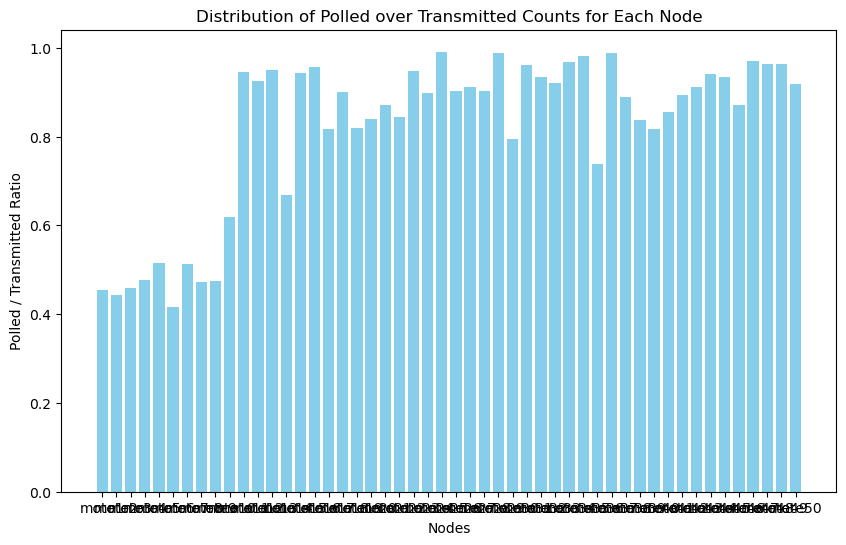

In [44]:
# Generate plot for distribution of polled over transmitted counts for each node
ratios = {mote:  transmitted_count[mote]/ polled_count[mote]  for mote in polled_count}

plt.figure(figsize=(10, 6))
plt.bar(ratios.keys(), ratios.values(), color='skyblue')
plt.xlabel('Nodes')
plt.ylabel('Polled / Transmitted Ratio')
plt.title('Distribution of Polled over Transmitted Counts for Each Node')
plt.show()

In [133]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load the pivot DataFrame
pivot_df = pd.read_csv('top_fifty_motes_temperatures.csv')

# Parameters
#A = np.array([[1, 1], [0, 1]])       # State transition matrix with delta_t=32 seconds
H = np.array([[1, 0]])                # Measurement matrix
Q = np.array([[1e-5, 0], [0, 1e-5]])  # Process noise covariance
R = np.array([[2]])                   # Measurement noise covariance
epsilon = 0.5                        # Sensitivity threshold for event detection
theta = 0.5                         # Threshold for significant change
num_nodes_to_poll_list = [1, 2, 5, 10, 20]  # List of numbers of nodes to poll
force_pull_threshold = 200             # Forcefully pull a node if it hasn't been pulled in the last 10 time steps

# Energy parameters in Joules
E_max = 162000  # Battery capacity in Joules
E_t = 50 / 1000  # Transmission energy in Joules
E_s = 10 / 1000  # Sensing energy in Joules
E_w = 10 / 1000  # Wake-up energy in Joules
E_0 = 1 / 1000   # Sleep energy in Joules


def get_state_transition_matrix(delta_t):
        return np.array([[1, delta_t], [0, 1]])
def run_simulation(num_nodes_to_poll):
    state_estimates = {f'mote{i}': np.array([[20], [0.01]]) for i in range(1, 51)}
    P = {f'mote{i}': np.zeros((2, 2)) for i in range(1, 51)}  # Initialize to zeros
    
    last_sensed_values = {f'mote{i}': 20.0 for i in range(1, 51)}
    last_update_times = {f'mote{i}': 0 for i in range(1, 51)}
    
    valuable_sensor_data = []
    polled_count = {f'mote{i}': 0 for i in range(1, 51)}
    transmitted_count = {f'mote{i}': 0 for i in range(1, 51)}
    
    def predict_node_state(x_hat, delta_t):
        return A @ x_hat
    
    def select_top_nodes(state_estimates, P, num_nodes_to_poll, currently_polled_nodes):
        covariance_traces = {mote: np.trace(P[mote]) for mote in state_estimates}
        sorted_motes_by_trace = sorted(covariance_traces, key=covariance_traces.get, reverse=True)
        top_nodes = set(sorted_motes_by_trace[:num_nodes_to_poll])
        return top_nodes | currently_polled_nodes

    for idx, row in pivot_df.iterrows():
        current_time_step = idx
        #delta_t_global = current_time_step - min(last_update_times.values())
        
        currently_polled_nodes = set()

        for mote, last_time in last_update_times.items():
            if current_time_step - last_time >= force_pull_threshold:
                currently_polled_nodes.add(mote)
                #print(f"Force pulling mote: {mote} at time step: {current_time_step}")

        top_sensors = select_top_nodes(state_estimates, P, num_nodes_to_poll, currently_polled_nodes)

        for mote in top_sensors:
            polled_count[mote] += 1
            measured_value = row[mote]
            previous_state = state_estimates[mote]
            previous_P = P[mote]
            delta_t = max(current_time_step - last_update_times[mote], 1)
            
            A = get_state_transition_matrix(delta_t)  # Get the dynamic state transition matrix
            xp = A @ previous_state
            Pp = A @ previous_P @ A.T + Q

            z = np.array([[measured_value]])
            K = Pp @ H.T @ np.linalg.inv(H @ Pp @ H.T + R)
            x_hat = xp + K @ (z - H @ xp)
            P_hat = Pp - K @ H @ Pp

            state_estimates[mote] = x_hat
            P[mote] = P_hat
            #P[mote] = np.zeros_like(P[mote])

            predicted_measurement = predict_node_state(x_hat, delta_t)[0, 0]

            if abs(measured_value - predicted_measurement) > theta:
                transmitted_count[mote] += 1
                last_sensed_values[mote] = measured_value

                valuable_sensor_data.append({
                    'index': current_time_step,
                    'selected_moteid': mote,
                    'temperature': measured_value,
                    'predicted_temperature': predicted_measurement,
                    'time_elapsed': delta_t
                })

            currently_polled_nodes.add(mote)
            last_update_times[mote] = current_time_step

    valuable_sensor_df = pd.DataFrame(valuable_sensor_data)

    valuable_sensor_df['squared_error'] = (valuable_sensor_df['temperature'] - valuable_sensor_df['predicted_temperature']) ** 2
    average_mse = valuable_sensor_df['squared_error'].mean()

    time_steps = len(pivot_df)
    fw = {mote: polled_count[mote] / time_steps for mote in polled_count}
    ft = {mote: transmitted_count[mote] / time_steps for mote in transmitted_count}

    average_lifetime_hours = np.mean([
        E_max / (ft[mote] * E_t + fw[mote] * (E_s + 3 * E_w) + (1 - fw[mote]) * E_0) for mote in polled_count
    ]) / 3600

    average_lifetime_years = average_lifetime_hours / 8760

    return average_mse, average_lifetime_years

results = {}

for num_nodes_to_poll in num_nodes_to_poll_list:
    print(f"Running simulation for {num_nodes_to_poll} nodes to poll...")
    mse, lifetime = run_simulation(num_nodes_to_poll)
    results[num_nodes_to_poll] = {'MSE': mse, 'Lifetime (years)': lifetime}
    print(f"Completed simulation for {num_nodes_to_poll} nodes to poll.")

# Print the results
for num_nodes_to_poll, metrics in results.items():
    print(f"Nodes to poll: {num_nodes_to_poll}")
    print(f"  Average MSE: {metrics['MSE']}")
    print(f"  Average sensor lifetime (years): {metrics['Lifetime (years)']}")


Running simulation for 1 nodes to poll...
Completed simulation for 1 nodes to poll.
Running simulation for 2 nodes to poll...
Completed simulation for 2 nodes to poll.
Running simulation for 5 nodes to poll...
Completed simulation for 5 nodes to poll.
Running simulation for 10 nodes to poll...
Completed simulation for 10 nodes to poll.
Running simulation for 20 nodes to poll...
Completed simulation for 20 nodes to poll.
Nodes to poll: 1
  Average MSE: 4.186062721656652
  Average sensor lifetime (years): 2.165718989003241
Nodes to poll: 2
  Average MSE: 4.539798653120265
  Average sensor lifetime (years): 1.5759166087058196
Nodes to poll: 5
  Average MSE: 5.3962175852079985
  Average sensor lifetime (years): 0.8826708199925544
Nodes to poll: 10
  Average MSE: 5.203522788145301
  Average sensor lifetime (years): 0.5097355283708503
Nodes to poll: 20
  Average MSE: 4.998906477985624
  Average sensor lifetime (years): 0.2971490744913968


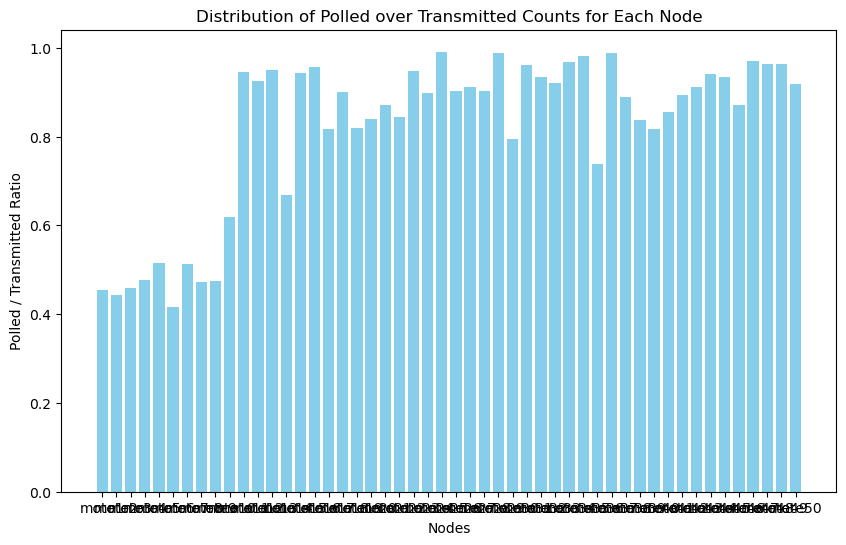

In [134]:
# Generate plot for distribution of polled over transmitted counts for each node
ratios = {mote:  transmitted_count[mote]/ polled_count[mote]  for mote in polled_count}

plt.figure(figsize=(10, 6))
plt.bar(ratios.keys(), ratios.values(), color='skyblue')
plt.xlabel('Nodes')
plt.ylabel('Polled / Transmitted Ratio')
plt.title('Distribution of Polled over Transmitted Counts for Each Node')
plt.show()

Running simulation for 1 nodes to poll...
Completed simulation for 1 nodes to poll.
Running simulation for 2 nodes to poll...
Completed simulation for 2 nodes to poll.
Running simulation for 5 nodes to poll...
Completed simulation for 5 nodes to poll.
Running simulation for 10 nodes to poll...
Completed simulation for 10 nodes to poll.
Running simulation for 20 nodes to poll...
Completed simulation for 20 nodes to poll.
Nodes to poll: 1
  Average MSE: 28884.530847457863
  Average sensor lifetime (years): 1.5846210967192333
Nodes to poll: 2
  Average MSE: 23339.840128418637
  Average sensor lifetime (years): 1.1432812078379573
Nodes to poll: 5
  Average MSE: 21305.152231457345
  Average sensor lifetime (years): 0.6026309647882226
Nodes to poll: 10
  Average MSE: 21760.81515359196
  Average sensor lifetime (years): 0.34431522318351665
Nodes to poll: 20
  Average MSE: 21354.012223866925
  Average sensor lifetime (years): 0.1892473829447976


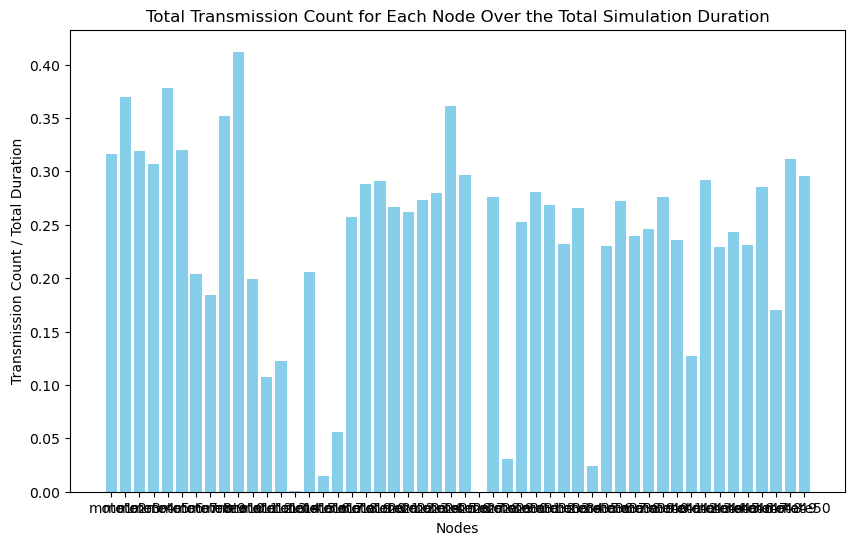

: 

In [96]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load the pivot DataFrame
pivot_df = pd.read_csv('top_fifty_motes_light.csv')
pivot_df = pivot_df.head(10000)

H = np.array([[1, 0]])                # Measurement matrix
Q = np.array([[1e-5, 0], [0, 1e-5]])  # Process noise covariance
R = np.array([[0.8]])                   # Measurement noise covariance
epsilon = 0.5                        # Sensitivity threshold for event detection
theta = 0.5                          # Threshold for significant change
num_nodes_to_poll_list = [1,2,5,10,20]  # List of numbers of nodes to poll
force_pull_threshold = 100            # Forcefully pull a node if it hasn't been pulled in the last 10 time steps
      # Forcefully pull a node if it hasn't been pulled in the last 10 time steps

# Energy parameters in Joules
E_max = 162000  # Battery capacity in Joules
E_t = 50 / 1000  # Transmission energy in Joules
E_s = 10 / 1000  # Sensing energy in Joules
E_w = 10 / 1000  # Wake-up energy in Joules
E_0 = 1 / 1000   # Sleep energy in Joules

def get_state_transition_matrix(delta_t):
    return np.array([[1, delta_t], [0, 1]])

def run_simulation(num_nodes_to_poll):
    state_estimates = {f'mote{i}': np.array([[300], [0.3]]) for i in range(1, 51)}
    P = {f'mote{i}': np.zeros((2,2))*10 for i in range(1, 51)}  # Initialize to zeros
    #P = {f'mote{i}': np.eye(2)*6 for i in range(1, 51)}  # Initialize to zeros
    
    last_sensed_values = {f'mote{i}': 300.0 for i in range(1, 51)}
    last_update_times = {f'mote{i}': 0 for i in range(1, 51)}
    
    valuable_sensor_data = []
    polled_count = {f'mote{i}': 0 for i in range(1, 51)}
    transmitted_count = {f'mote{i}': 0 for i in range(1, 51)}
    
    def predict_node_state(x_hat, delta_t):
        A = get_state_transition_matrix(delta_t)  # Get the dynamic state transition matrix
        return A @ x_hat
    
    def select_top_nodes(state_estimates, P, num_nodes_to_poll, currently_polled_nodes):
        covariance_traces = {mote: np.trace(P[mote]) for mote in state_estimates}
        sorted_motes_by_trace = sorted(covariance_traces, key=covariance_traces.get, reverse=True)
        top_nodes = set(sorted_motes_by_trace[:num_nodes_to_poll])
        return top_nodes | currently_polled_nodes

    for idx, row in pivot_df.iterrows():
        current_time_step = idx
        currently_polled_nodes = set()

        for mote, last_time in last_update_times.items():
            if current_time_step - last_time >= force_pull_threshold:
                currently_polled_nodes.add(mote)

        top_sensors = select_top_nodes(state_estimates, P, num_nodes_to_poll, currently_polled_nodes)

        for mote in top_sensors:
            polled_count[mote] += 1
            measured_value = row[mote]
            previous_state = state_estimates[mote]
            previous_P = P[mote]
            delta_t = max(current_time_step - last_update_times[mote], 1)
            
            A = get_state_transition_matrix(delta_t)  # Get the dynamic state transition matrix
            xp = A @ previous_state
            Pp = A @ previous_P @ A.T + Q

            z = np.array([[measured_value]])
            K = Pp @ H.T @ np.linalg.inv(H @ Pp @ H.T + R)
            x_hat = xp + K @ (z - H @ xp)
            P_hat = Pp - K @ H @ Pp

            state_estimates[mote] = x_hat
            P[mote] = P_hat

            predicted_measurement = predict_node_state(x_hat, delta_t)[0, 0]

            if abs(measured_value - predicted_measurement) > theta:
                transmitted_count[mote] += 1
                last_sensed_values[mote] = measured_value

                valuable_sensor_data.append({
                    'index': current_time_step,
                    'selected_moteid': mote,
                    'temperature': measured_value,
                    'predicted_temperature': predicted_measurement,
                    'time_elapsed': delta_t
                })

            currently_polled_nodes.add(mote)
            last_update_times[mote] = current_time_step

    valuable_sensor_df = pd.DataFrame(valuable_sensor_data)

    valuable_sensor_df['squared_error'] = (valuable_sensor_df['temperature'] - valuable_sensor_df['predicted_temperature']) ** 2
    average_mse = valuable_sensor_df['squared_error'].mean()

    time_steps = len(pivot_df)
    fw = {mote: polled_count[mote] / time_steps for mote in polled_count}
    ft = {mote: transmitted_count[mote] / time_steps for mote in transmitted_count}

    average_lifetime_hours = np.mean([
        E_max / (ft[mote] * E_t + fw[mote] * (E_s + 3 * E_w) + (1 - fw[mote]) * E_0) for mote in polled_count
    ]) / 3600

    average_lifetime_years = average_lifetime_hours / 8760

    return average_mse, average_lifetime_years, transmitted_count

results = {}

for num_nodes_to_poll in num_nodes_to_poll_list:
    print(f"Running simulation for {num_nodes_to_poll} nodes to poll...")
    mse, lifetime, transmitted_count = run_simulation(num_nodes_to_poll)
    results[num_nodes_to_poll] = {'MSE': mse, 'Lifetime (years)': lifetime}
    print(f"Completed simulation for {num_nodes_to_poll} nodes to poll.")

# Print the results
for num_nodes_to_poll, metrics in results.items():
    print(f"Nodes to poll: {num_nodes_to_poll}")
    print(f"  Average MSE: {metrics['MSE']}")
    print(f"  Average sensor lifetime (years): {metrics['Lifetime (years)']}")

# Plot the total transmission count for each node against the total simulation time steps
total_duration = len(pivot_df)
ratios = {mote: transmitted_count[mote] / total_duration for mote in transmitted_count}

plt.figure(figsize=(10, 6))
plt.bar(ratios.keys(), ratios.values(), color='skyblue')
plt.xlabel('Nodes')
plt.ylabel('Transmission Count / Total Duration')
plt.title('Total Transmission Count for Each Node Over the Total Simulation Duration')
plt.show()


In [29]:
pivot_df = pd.read_csv('top_fifty_motes_humidity.csv')
len(pivot_df)

10000

# Kalman filter estimation for each node

In [3]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error

# Load the pivot table containing node data (voltage readings in this case)
#pivot_df = pd.read_csv('top_fifty_motes_voltage.csv')
pivot_df = pd.read_csv('top_fifty_motes_temperatures.csv')
#pivot_df = pd.read_csv('simulated_sensor_data_50k.csv')
pivot_df = pivot_df.apply(lambda x: x.fillna(x.mean()), axis=0)
pivot_df = pivot_df.head(10000)


# Assuming 50 nodes and an initial guess for the state estimate and covariance matrix
num_nodes = 50
A = np.array([[1]])  # State transition matrix (for simplicity, it's 1 for now)
H = np.array([[1]])  # Measurement matrix
Q = np.array([[1]])  # Process noise covariance matrix
R = np.array([[0.5]])  # Measurement noise covariance matrix

# Initialize state estimates (x_hat) and covariance (P) for each node
x_hat = {i: np.array([[0]]) for i in range(1, num_nodes + 1)}  # Initial state estimate for all nodes
P = {i: np.array([[1]]) for i in range(1, num_nodes + 1)}  # Initial covariance for all nodes

# Set threshold for node transmission
transmission_threshold = 0.5

# Initialize dictionaries to store actual and predicted values for each node
actual_values = {i: [] for i in range(1, num_nodes + 1)}
predicted_values = {i: [] for i in range(1, num_nodes + 1)}

# Define Kalman Filter Prediction and Update Functions
def kalman_predict(x_hat, P, A, Q):
    xp = A @ x_hat  # Predicted state estimate
    Pp = A @ P @ A.T + Q  # Predicted covariance
    return xp, Pp

def kalman_update(xp, Pp, measurement, H, R):
    K = Pp @ H.T @ np.linalg.inv(H @ Pp @ H.T + R)  # Kalman Gain
    x_hat = xp + K @ (measurement - H @ xp)  # Updated state estimate
    P = Pp - K @ H @ Pp  # Updated covariance
    return x_hat, P

# Polling function to poll the top M nodes with the highest covariance trace
def poll_nodes(pivot_df, current_time_step, x_hat, P, A, Q, H, R, transmission_threshold, actual_values, predicted_values, M):
    """Poll the top M nodes with the highest covariance trace and update the sink's state estimates."""
    # Sort nodes by the trace of their covariance matrix and pick the top M
    nodes_to_poll = sorted(P.keys(), key=lambda i: np.trace(P[i]), reverse=True)[:M]

    for node_to_poll in nodes_to_poll:
        # Predict the next state for this node
        xp, Pp = kalman_predict(x_hat[node_to_poll], P[node_to_poll], A, Q)

        # Get the current actual measurement from the dataset
        actual_measurement = pivot_df[f'mote{node_to_poll}'].iloc[current_time_step]

        # Store the actual and predicted values for MSE calculation later
        actual_values[node_to_poll].append(actual_measurement)
        predicted_values[node_to_poll].append(xp.flatten()[0])

        # Check if the predicted state differs from the actual by more than the threshold
        if abs(H @ xp - actual_measurement) > transmission_threshold:
            # Node transmits, so we update the sink's estimate
            x_hat[node_to_poll], P[node_to_poll] = kalman_update(xp, Pp, actual_measurement, H, R)
            print(f"Node {node_to_poll} transmitted new value: {actual_measurement}")
        else:
            # No transmission, estimate remains the same
            print(f"Node {node_to_poll} did not transmit, prediction remains: {xp.flatten()}")

    return x_hat, P, actual_values, predicted_values

# Example for running the process across time steps
M = 5  # Number of nodes to poll at each time step
for t in range(len(pivot_df)):
    x_hat, P, actual_values, predicted_values = poll_nodes(pivot_df, t, x_hat, P, A, Q, H, R, transmission_threshold, actual_values, predicted_values, M)

# Calculate MSE for each node at the end of the simulation
mse_per_node = {i: mean_squared_error(actual_values[i], predicted_values[i]) for i in range(1, num_nodes + 1)}

# Print the MSE for each node
for node, mse in mse_per_node.items():
    print(f"Node {node}: Average MSE = {mse:.4f}")


Node 1 transmitted new value: 19.9884
Node 2 transmitted new value: 19.567
Node 3 transmitted new value: 20.204
Node 4 transmitted new value: 23.0558
Node 5 transmitted new value: 20.4196
Node 6 transmitted new value: 19.42
Node 7 transmitted new value: 19.0084
Node 8 transmitted new value: 19.0672
Node 9 transmitted new value: 19.273
Node 10 transmitted new value: 18.6556
Node 11 transmitted new value: 17.1856
Node 12 transmitted new value: 17.8324
Node 13 transmitted new value: 17.8324
Node 14 transmitted new value: 21.331
Node 15 transmitted new value: 21.233
Node 16 transmitted new value: 16.6956
Node 17 transmitted new value: 18.9398
Node 18 transmitted new value: 19.0966
Node 19 transmitted new value: 23.095
Node 20 transmitted new value: 19.175
Node 21 transmitted new value: 21.6152
Node 22 transmitted new value: -38.4
Node 23 transmitted new value: 18.8124
Node 24 transmitted new value: -16.8988
Node 25 transmitted new value: 18.783
Node 26 transmitted new value: 19.4592
Node 2

In [30]:

import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error

# Load the pivot table containing node data (voltage readings in this case)
#pivot_df = pd.read_csv('top_fifty_motes_voltage.csv')
pivot_df = pd.read_csv('top_fifty_motes_temperatures.csv')
#pivot_df = pd.read_csv('simulated_sensor_data_50k.csv')
pivot_df = pivot_df.apply(lambda x: x.fillna(x.mean()), axis=0)
pivot_df = pivot_df.head(10000)

# Kalman filter parameters
num_nodes = 50
A = np.array([[1]])  # Transition matrix
Q = np.array([[0.001]])  # Process noise covariance
H = np.array([[1]])  # Measurement matrix
R = np.array([[0.01]])  # Measurement noise covariance

# Initialize the state estimates and covariance matrices for each node
x_hat = {i: np.array([[0]]) for i in range(1, num_nodes + 1)}  # State estimate
P = {i: np.array([[1]]) for i in range(1, num_nodes + 1)}  # Covariance matrix

# Default covariance to reset after a successful transmission
default_covariance = np.array([[0]])

# Threshold for deciding whether a node should transmit its value
transmission_threshold = 0.5

# Data structures to store actual and predicted values for MSE calculation
actual_values = {i: [] for i in range(1, num_nodes + 1)}
predicted_values = {i: [] for i in range(1, num_nodes + 1)}

# Kalman filter prediction step
def kalman_predict(x_hat, P, A, Q):
    xp = A @ x_hat  # Predict the next state
    Pp = A @ P @ A.T + Q  # Predict the next covariance
    return xp, Pp

# Kalman filter update step
def kalman_update(xp, Pp, measurement, H, R):
    K = Pp @ H.T @ np.linalg.inv(H @ Pp @ H.T + R)  # Kalman gain
    x_hat_updated = xp + K @ (measurement - H @ xp)  # Update the state estimate
    P_updated = Pp - K @ H @ Pp  # Update the covariance
    return x_hat_updated, P_updated

# Polling function to select top M nodes based on covariance trace
def poll_nodes(pivot_df, current_time_step, x_hat, P, A, Q, H, R, transmission_threshold, actual_values, predicted_values, M, default_covariance):
    """Poll the top M nodes with the highest covariance trace and update the sink's state estimates."""
    # Sort nodes by the trace of their covariance matrix and pick the top M
    nodes_to_poll = sorted(P.keys(), key=lambda i: np.trace(P[i]), reverse=True)[:M]

    for node_to_poll in nodes_to_poll:
        # Predict the next state for this node
        xp, Pp = kalman_predict(x_hat[node_to_poll], P[node_to_poll], A, Q)

        # Get the current actual measurement from the dataset
        actual_measurement = pivot_df[f'mote{node_to_poll}'].iloc[current_time_step]

        # Store the actual and predicted values for MSE calculation later
        actual_values[node_to_poll].append(actual_measurement)
        predicted_values[node_to_poll].append(xp.flatten()[0])

        # Check if the predicted state differs from the actual by more than the threshold
        if abs(H @ xp - actual_measurement) > transmission_threshold:
            # Node transmits, so we update the sink's estimate
            x_hat[node_to_poll], P[node_to_poll] = kalman_update(xp, Pp, actual_measurement, H, R)
            # Reset the covariance to the default value after successful transmission
            P[node_to_poll] = default_covariance
            print(f"Node {node_to_poll} transmitted new value: {actual_measurement}")
        else:
            # No transmission, estimate remains the same
            print(f"Node {node_to_poll} did not transmit, prediction remains: {xp.flatten()}")

    return x_hat, P, actual_values, predicted_values

# Simulation loop
M = 30  # Number of nodes to poll at each time step

for t in range(len(pivot_df)):
    x_hat, P, actual_values, predicted_values = poll_nodes(pivot_df, t, x_hat, P, A, Q, H, R, transmission_threshold, actual_values, predicted_values, M, default_covariance)

# Calculate MSE for each node at the end of the simulation
# Calculate MSE for each node at the end of the simulation
mse_per_node = {}
total_mse = 0  # Initialize a variable to store the total MSE
valid_node_count = 0  # Initialize a variable to store the count of valid nodes

for i in range(1, num_nodes + 1):
    if len(actual_values[i]) > 0 and len(predicted_values[i]) > 0:
        mse = mean_squared_error(actual_values[i], predicted_values[i])
        mse_per_node[i] = mse
        total_mse += mse  # Add the MSE of the current node to the total MSE
        valid_node_count += 1  # Increment the valid node count
    else:
        mse_per_node[i] = None  # Assign None if no data is available

# Print the MSE for each node
for node, mse in mse_per_node.items():
    if mse is not None:
        print(f"Node {node}: Average MSE = {mse:.4f}")
    else:
        print(f"Node {node}: No data available for MSE calculation.")

# Print the total and average MSE over all the nodes
if valid_node_count > 0:
    average_mse = total_mse / valid_node_count  # Calculate the average MSE
    print(f"Average MSE across all valid nodes: {average_mse:.4f}")
else:
    print("No valid nodes for MSE calculation.")





Node 1 transmitted new value: 19.9884
Node 2 transmitted new value: 19.567
Node 3 transmitted new value: 20.204
Node 4 transmitted new value: 23.0558
Node 5 transmitted new value: 20.4196
Node 6 transmitted new value: 19.4298
Node 7 transmitted new value: 19.1848
Node 8 transmitted new value: 19.0672
Node 9 transmitted new value: 19.3612
Node 10 transmitted new value: 21.772
Node 11 transmitted new value: 19.5964
Node 12 transmitted new value: 17.8422
Node 13 transmitted new value: 21.2722
Node 14 transmitted new value: 21.6348
Node 15 transmitted new value: 21.8308
Node 16 transmitted new value: 16.9308
Node 17 transmitted new value: 19.2534
Node 18 transmitted new value: 19.7336
Node 19 transmitted new value: 21.576
Node 20 transmitted new value: 19.5964
Node 21 transmitted new value: 22.017
Node 22 transmitted new value: -38.4
Node 23 transmitted new value: 19.7728
Node 24 transmitted new value: 19.616
Node 25 transmitted new value: 19.4494
Node 26 transmitted new value: 20.1354
Nod

In [29]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error

# Load the pivot table containing node data (voltage readings in this case)
#pivot_df = pd.read_csv('top_fifty_motes_voltage.csv')
pivot_df = pd.read_csv('top_fifty_motes_temperatures.csv')
#pivot_df = pd.read_csv('simulated_sensor_data_50k.csv')
pivot_df = pivot_df.apply(lambda x: x.fillna(x.mean()), axis=0)
pivot_df = pivot_df.head(10000)

# Initialize parameters
num_nodes = 50
delta_t = 1  # Time step between measurements
transmission_threshold = 0.5  # Threshold to trigger polling
q_1 = 1e-5  # Process noise for value at the node
q_2 = 1e-5  # Process noise for rate of change at the node
R = 0.1 # Measurement noise

# Initialize state vector (value and rate of change) and covariance for each node at the node-side
x_hat_node = {f'mote{i}': np.array([20.0, 0.0]) for i in range(1, num_nodes + 1)}
P_node = {f'mote{i}': np.eye(2) for i in range(1, num_nodes + 1)}  # Covariance matrix for each node at the node-side

# Initialize state vector (value and rate of change) for each node at the sink-side
x_hat_sink = {f'mote{i}': np.array([300.0, 0.0]) for i in range(1, num_nodes + 1)}

# Kalman filter matrices for the node-side
A_node = np.array([[1, delta_t],  # State transition matrix
                   [0, 1]])
Q_node = np.array([[q_1, 0],      # Process noise covariance matrix
                   [0, q_2]])
H_node = np.array([[1, 0]])        # Observation matrix (only observing the value)

# Function to run the Kalman filter at the node side
def kalman_node(measured_value, x_hat, P):
    # Prediction step (predict value and rate of change)
    xp = A_node @ x_hat
    Pp = A_node @ P @ A_node.T + Q_node
    
    # Update step (if the node is polled)
    K = Pp @ H_node.T @ np.linalg.inv(H_node @ Pp @ H_node.T + R)
    x_hat = xp + K @ (measured_value - H_node @ xp)
    P = Pp - K @ H_node @ Pp
    return x_hat, P

# Function to predict the state at the sink side based on the last received state and rate of change
def predict_sink_state(x_hat, delta_t):
    # Update value at the sink side using the rate of change
    x_hat[0] = x_hat[0] + x_hat[1] * delta_t
    return x_hat

# Function to poll nodes based on the threshold exceedance at the sink
def poll_nodes(pivot_df, time_step, x_hat_node, x_hat_sink, P_node, actual_values, predicted_values, M):
    exceedance_values = {}

    # Predict values at the sink for each node and check if the threshold is exceeded
    for mote in range(1, num_nodes + 1):
        column_name = f'mote{mote}'
        predicted_value = x_hat_sink[column_name][0]  # Predicted value at the sink
        
        # Store the difference from the actual value
        measured_value = pivot_df.loc[time_step, column_name]
        if abs(predicted_value - measured_value) > transmission_threshold:
            exceedance_values[mote] = abs(predicted_value - measured_value)

    # Sort by largest threshold exceedance and select top M nodes to poll
    nodes_to_poll = sorted(exceedance_values, key=exceedance_values.get, reverse=True)[:M]

    for mote in nodes_to_poll:
        column_name = f'mote{mote}'
        measured_value = pivot_df.loc[time_step, column_name]

        # Node performs Kalman filtering to update its state
        x_hat_node[column_name], P_node[column_name] = kalman_node(measured_value, x_hat_node[column_name], P_node[column_name])

        # Node sends its current state and rate of change to the sink
        x_hat_sink[column_name] = x_hat_node[column_name]  # Only update sink state when node is polled

        # Store the actual and predicted values
        actual_values[mote].append(measured_value)
        predicted_values[mote].append(x_hat_sink[column_name][0])  # Store the predicted value (first component)

    return x_hat_node, x_hat_sink, P_node, actual_values, predicted_values

# Initialize actual and predicted value storage
actual_values = {i: [] for i in range(1, num_nodes + 1)}
predicted_values = {i: [] for i in range(1, num_nodes + 1)}

# Simulation settings
num_steps = len(pivot_df)  # Number of time steps in the dataset
M = 5  # Number of nodes to poll at each time step

# Run the simulation
for t in range(num_steps):
    # Predict the state at the sink for all nodes
    for mote in range(1, num_nodes + 1):
        column_name = f'mote{mote}'
        x_hat_sink[column_name] = predict_sink_state(x_hat_sink[column_name], delta_t)

    # Poll nodes based on threshold exceedance
    x_hat_node, x_hat_sink, P_node, actual_values, predicted_values = poll_nodes(pivot_df, t, x_hat_node, x_hat_sink, P_node, actual_values, predicted_values, M)

# Calculate the MSE for each node at the end of the simulation
mse_per_node = {i: mean_squared_error(actual_values[i], predicted_values[i]) for i in range(1, num_nodes + 1) if len(actual_values[i]) > 0}

# Print the MSE for each node
for node, mse in mse_per_node.items():
    print(f"Node {node}: Average MSE = {mse:.4f}")

# Calculate the average MSE over all nodes
average_mse = np.mean(list(mse_per_node.values()))
print(f"Average MSE across all nodes: {average_mse:.4f}")




Node 1: Average MSE = 0.6052
Node 2: Average MSE = 1.3761
Node 3: Average MSE = 0.6028
Node 4: Average MSE = 0.6864
Node 5: Average MSE = 0.7123
Node 6: Average MSE = 1.5227
Node 7: Average MSE = 1.6683
Node 8: Average MSE = 0.7403
Node 9: Average MSE = 0.7073
Node 10: Average MSE = 4.3605
Node 11: Average MSE = 0.9978
Node 12: Average MSE = 1.5844
Node 13: Average MSE = 1.1058
Node 14: Average MSE = 3.5880
Node 15: Average MSE = 1.5395
Node 16: Average MSE = 1.1433
Node 17: Average MSE = 1.7351
Node 18: Average MSE = 0.8431
Node 19: Average MSE = 29.2422
Node 20: Average MSE = 24.3282
Node 21: Average MSE = 1.3061
Node 22: Average MSE = 43.4816
Node 23: Average MSE = 31.7888
Node 24: Average MSE = 11.1967
Node 25: Average MSE = 10.0587
Node 26: Average MSE = 7.3945
Node 27: Average MSE = 0.7484
Node 28: Average MSE = 1.0824
Node 29: Average MSE = 7.8955
Node 30: Average MSE = 0.8208
Node 31: Average MSE = 2.8467
Node 32: Average MSE = 0.8401
Node 33: Average MSE = 0.9672
Node 34: Aver